In [24]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.preprocessing import StandardScaler
from keras.utils import to_categorical
from keras.models import Sequential # for creating a linear stack of layers for our Neural Network
from keras import Input # for instantiating a keras tensor
from keras.layers import Dense, SimpleRNN
from sklearn.model_selection import train_test_split
from keras.layers import Dense, LSTM, Dropout

In [4]:
from google.colab import files
file = files.upload()

Saving NNDL_finaldataset.csv to NNDL_finaldataset (1).csv


In [5]:
df = pd.read_csv('NNDL_finaldataset.csv')
df

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,D
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,D
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,D
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,D
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9868,-0.003709,-0.006168,0.000786,-0.000155,0.001088,-0.000144,-0.003815,-0.004658,0.000656,0.000060,...,4.199645,1.939572,3.801623,5.192412,1.812156,5.206748,5.086565,1.837070,5432739,D
9869,-0.000727,0.001536,-0.000211,0.000700,-0.000975,0.000067,-0.001147,0.000177,0.000008,0.000423,...,4.199096,1.939843,3.736713,5.067120,1.828599,5.205452,5.085346,1.837165,5432771,D
9870,0.003074,0.007870,-0.000962,0.000526,-0.000779,0.000090,0.002786,0.005035,-0.000606,0.000413,...,4.200613,1.940351,3.736855,5.068608,1.828367,5.202618,5.090534,1.836787,5432808,D
9871,0.003297,0.008467,-0.001035,0.000578,-0.000740,0.000101,0.002947,0.005385,-0.000652,0.000580,...,4.200203,1.940679,3.736708,5.067500,1.828450,5.196628,5.095811,1.836236,5432836,D


Data pre-processing

In [ ]:
df1 = pd.read_csv('a1_va3.csv')
df2 = pd.read_csv('a1_raw_processed.csv')
df3 = pd.read_csv('a2_va3.csv')
df4 = pd.read_csv('a2_raw_processed.csv')
df5 = pd.read_csv('a3_va3.csv')
df6 = pd.read_csv('a3_raw_processed.csv')
df7 = pd.read_csv('b1_va3.csv')
df8 = pd.read_csv('b1_raw_processed.csv')
df9 = pd.read_csv('b3_va3.csv')
df10 = pd.read_csv('b3_raw_processed.csv')
df11 = pd.read_csv('c1_va3.csv')
df12 = pd.read_csv('c1_raw_processed.csv')
df13 = pd.read_csv('c3_va3.csv')
df14 = pd.read_csv('c3_raw_processed.csv')

In [ ]:
df1

,1,2,3,4,5,6,7,8,9,10,...,24,25,26,27,28,29,30,31,32,Phase
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,1.880800e-04,0.005133,0.010400,0.000646,0.007871,0.004631,0.000963,0.000092,0.000438,D
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,-7.500000e-07,0.005093,0.005756,0.000573,0.003459,0.000730,0.000332,0.000012,0.000433,D
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,-3.920000e-05,0.002406,0.003279,0.000452,0.003261,0.002412,0.000852,0.000042,0.000202,D
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,-3.184000e-05,0.001416,0.001334,0.000493,0.001358,0.000313,0.000611,0.000029,0.000596,D
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,-2.015000e-05,0.000158,0.001709,0.000325,0.001713,0.000203,0.000069,0.000038,0.000069,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1738,0.001042,0.000111,-0.000199,-0.009265,0.002095,-0.000616,0.001041,0.000117,-0.000199,-0.000098,...,7.890000e-05,0.001067,0.009519,0.001066,0.000232,0.000015,0.000210,0.000016,0.000308,D
1739,0.000883,0.000107,-0.000172,0.013037,-0.001307,0.000705,0.000881,0.000115,-0.000172,0.001688,...,2.084600e-04,0.000906,0.013122,0.000905,0.001851,0.000052,0.007290,0.000052,0.000623,D
1740,-0.000141,-0.000053,0.000007,0.011722,-0.000576,0.000647,-0.000143,-0.000045,0.000007,0.001912,...,-1.458000e-05,0.000151,0.011754,0.000150,0.002075,0.000339,0.000486,0.000339,0.000081,D
1741,-0.000043,-0.000060,-0.000004,0.009195,-0.000926,0.000624,-0.000043,-0.000059,-0.000004,0.001912,...,-2.543000e-05,0.000074,0.009262,0.000073,0.001950,0.000016,0.000411,0.000016,0.000136,D


In [ ]:
df2

,lhx,lhy,lhz,rhx,rhy,rhz,hx,hy,hz,sx,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,5.347435,4.363681,1.501913,5.258967,4.319263,1.488703,5.037871,1.618295,1.778350,5.062803,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,Rest
1,4.869622,4.254210,1.556133,5.240113,4.346338,1.554309,5.037610,1.618370,1.778573,5.061430,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,Rest
2,5.357447,4.364039,1.500969,5.238928,4.347924,1.554150,5.037514,1.618298,1.778774,5.059245,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,Rest
3,4.942886,4.281878,1.546513,5.111436,4.229660,1.527091,5.037526,1.618612,1.778855,5.056475,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,Rest
4,5.003160,4.278530,1.542866,4.985812,4.182155,1.520330,5.037557,1.619226,1.778925,5.052367,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1738,4.999737,3.840355,1.577457,4.990017,4.124610,1.546410,5.092207,1.616004,1.793314,5.094342,4.235239,1.776703,4.911455,4.145016,1.575040,5.121212,4.173772,1.590187,5807375,Rest
1739,5.001617,3.840771,1.577161,4.695521,4.148509,1.530205,5.092773,1.615753,1.793486,5.094236,4.235837,1.776754,4.913334,4.145438,1.574744,5.072464,4.175019,1.580585,5807406,Rest
1740,4.996975,3.841236,1.578423,4.700123,4.141193,1.530697,5.092515,1.615095,1.793637,5.093153,4.235420,1.776905,4.908689,4.145911,1.576006,5.074112,4.178266,1.581682,5807437,Rest
1741,5.000125,3.841455,1.577914,4.690338,4.153884,1.526481,5.092476,1.614777,1.793768,5.093362,4.234446,1.777077,4.911839,4.146133,1.575497,5.058132,4.166863,1.579690,5807499,Rest


In [ ]:
mapping_dict = {
    'Rest': 'D',
    'Preparation': 'P',
    'Stroke': 'S',
    'Hold': 'H',
    'Retraction': 'R'
}

In [ ]:
df2['phase'] = df2['phase'].map(mapping_dict)

In [ ]:
df2

,lhx,lhy,lhz,rhx,rhy,rhz,hx,hy,hz,sx,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,5.347435,4.363681,1.501913,5.258967,4.319263,1.488703,5.037871,1.618295,1.778350,5.062803,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,D
1,4.869622,4.254210,1.556133,5.240113,4.346338,1.554309,5.037610,1.618370,1.778573,5.061430,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,D
2,5.357447,4.364039,1.500969,5.238928,4.347924,1.554150,5.037514,1.618298,1.778774,5.059245,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,D
3,4.942886,4.281878,1.546513,5.111436,4.229660,1.527091,5.037526,1.618612,1.778855,5.056475,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,D
4,5.003160,4.278530,1.542866,4.985812,4.182155,1.520330,5.037557,1.619226,1.778925,5.052367,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1738,4.999737,3.840355,1.577457,4.990017,4.124610,1.546410,5.092207,1.616004,1.793314,5.094342,4.235239,1.776703,4.911455,4.145016,1.575040,5.121212,4.173772,1.590187,5807375,D
1739,5.001617,3.840771,1.577161,4.695521,4.148509,1.530205,5.092773,1.615753,1.793486,5.094236,4.235837,1.776754,4.913334,4.145438,1.574744,5.072464,4.175019,1.580585,5807406,D
1740,4.996975,3.841236,1.578423,4.700123,4.141193,1.530697,5.092515,1.615095,1.793637,5.093153,4.235420,1.776905,4.908689,4.145911,1.576006,5.074112,4.178266,1.581682,5807437,D
1741,5.000125,3.841455,1.577914,4.690338,4.153884,1.526481,5.092476,1.614777,1.793768,5.093362,4.234446,1.777077,4.911839,4.146133,1.575497,5.058132,4.166863,1.579690,5807499,D


In [ ]:
df1['Phase'].unique()

array(['D', 'P', 'S', 'H', 'R'], dtype=object)

In [ ]:
df2['phase'].unique()

array(['D', 'P', 'S', 'H', 'R'], dtype=object)

In [ ]:
df1['Phase'].value_counts()

D    694
S    656
R    191
P    163
H     39
Name: Phase, dtype: int64

In [ ]:
df2['phase'].value_counts()

D    694
S    656
R    191
P    163
H     39
Name: phase, dtype: int64

In [ ]:
df1.shape

(1743, 33)

In [ ]:
df2.shape

(1743, 20)

In [ ]:
df1df2 = pd.concat([df1, df2], axis="columns")
df1df2

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,D
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,D
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,D
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,D
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1738,0.001042,0.000111,-0.000199,-0.009265,0.002095,-0.000616,0.001041,0.000117,-0.000199,-0.000098,...,4.235239,1.776703,4.911455,4.145016,1.575040,5.121212,4.173772,1.590187,5807375,D
1739,0.000883,0.000107,-0.000172,0.013037,-0.001307,0.000705,0.000881,0.000115,-0.000172,0.001688,...,4.235837,1.776754,4.913334,4.145438,1.574744,5.072464,4.175019,1.580585,5807406,D
1740,-0.000141,-0.000053,0.000007,0.011722,-0.000576,0.000647,-0.000143,-0.000045,0.000007,0.001912,...,4.235420,1.776905,4.908689,4.145911,1.576006,5.074112,4.178266,1.581682,5807437,D
1741,-0.000043,-0.000060,-0.000004,0.009195,-0.000926,0.000624,-0.000043,-0.000059,-0.000004,0.001912,...,4.234446,1.777077,4.911839,4.146133,1.575497,5.058132,4.166863,1.579690,5807499,D


In [ ]:
df4['phase'] = df4['phase'].map(mapping_dict)

In [ ]:
df3['Phase'].unique()

array(['D', 'P', 'S', 'R', 'H'], dtype=object)

In [ ]:
df4['phase'].unique()

array(['D', 'P', 'S', 'R', 'H'], dtype=object)

In [ ]:
df3['Phase'].value_counts()

D    489
S    431
P    200
R     86
H     54
Name: Phase, dtype: int64

In [ ]:
df4['phase'].value_counts()

D    489
S    431
P    200
R     86
H     54
Name: phase, dtype: int64

In [ ]:
df3.shape

(1260, 33)

In [ ]:
df4.shape

(1260, 20)

In [ ]:
df3df4 = pd.concat([df3, df4], axis="columns")
df3df4

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,0.000005,-0.001857,0.000168,0.000131,-0.000346,0.000133,-0.001732,-0.001807,0.000532,-0.000080,...,4.109216,1.777594,4.503417,5.200345,1.703773,6.615753,5.206142,1.654574,5103698,D
1,-0.000315,-0.001373,0.000267,-0.001972,0.003837,-0.000523,-0.001306,-0.001276,0.000491,-0.000075,...,4.109312,1.777365,4.504666,5.163178,1.702907,6.617512,5.181194,1.656543,5103729,D
2,-0.000062,0.000436,0.000166,0.001393,-0.000442,0.000208,0.000978,0.000517,-0.000007,-0.000097,...,4.109371,1.777066,4.500359,5.140639,1.703089,6.616439,5.206642,1.653940,5103762,D
3,0.000727,0.001626,0.000234,-0.000131,0.000611,-0.000129,0.001150,0.001554,-0.000068,0.000364,...,4.111345,1.776608,4.555069,5.213144,1.687992,6.610823,5.244353,1.655494,5103795,D
4,0.000675,0.000493,0.000179,0.001253,-0.002160,0.000288,0.000606,0.000395,-0.000015,0.001053,...,4.110899,1.776406,4.550096,5.212202,1.688152,6.621651,5.184755,1.650331,5103827,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1255,-0.000205,-0.011925,-0.001228,-0.000068,-0.009515,-0.000888,-0.006188,-0.001810,-0.001355,-0.000769,...,4.153896,1.700377,4.035254,4.780551,1.625402,6.644851,4.683230,1.522554,5155770,R
1256,-0.000512,-0.008675,-0.000836,0.000104,-0.006742,-0.000619,-0.007582,-0.007929,-0.000503,-0.001528,...,4.153625,1.699941,4.155283,5.046596,1.621549,6.672435,4.837710,1.516715,5155833,R
1257,-0.000679,-0.005859,-0.000635,0.000279,-0.006121,-0.000282,-0.003322,-0.006726,-0.000052,-0.001570,...,4.152654,1.699411,4.154757,5.052544,1.622160,6.684550,4.894862,1.529447,5155902,R
1258,-0.001319,-0.004339,-0.000651,0.000340,-0.004804,-0.000550,-0.003313,-0.006431,0.000018,-0.000515,...,4.152353,1.699148,4.155412,5.076689,1.623406,6.632552,4.916888,1.539666,5155939,R


In [ ]:
df6['phase'] = df6['phase'].map(mapping_dict)

In [ ]:
df5['Phase'].unique()

array(['D', 'P', 'S', 'R', 'H'], dtype=object)

In [ ]:
df6['phase'].unique()

array(['D', 'P', 'S', 'R', 'H'], dtype=object)

In [ ]:
df5['Phase'].value_counts()

D    658
S    535
P    279
R    208
H    150
Name: Phase, dtype: int64

In [ ]:
df6['phase'].value_counts()

D    658
S    535
P    279
R    208
H    150
Name: phase, dtype: int64

In [ ]:
df5.shape

(1830, 33)

In [ ]:
df6.shape

(1830, 20)

In [ ]:
df5df6 = pd.concat([df5, df6], axis="columns")
df5df6

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.000010,-0.000021,0.000005,-0.000006,0.000043,-0.000011,0.000004,-0.000027,0.000006,-2.852000e-05,...,3.476750,2.430243,1.946558,4.519551,2.247933,3.224442,4.237915,2.333757,4134469,D
1,-0.000006,-0.000017,0.000004,-0.000020,0.000064,-0.000010,0.000008,-0.000023,0.000005,-4.526000e-05,...,3.476661,2.430296,1.946477,4.519677,2.247939,3.224355,4.237834,2.333824,4134501,D
2,-0.000025,-0.000026,0.000004,-0.000027,0.000061,-0.000008,-0.000005,-0.000030,0.000007,-5.296000e-05,...,3.476560,2.430351,1.946404,4.519819,2.247944,3.224269,4.237745,2.333894,4134537,D
3,-0.000041,-0.000037,0.000005,-0.000033,0.000060,-0.000006,-0.000020,-0.000038,0.000009,-5.116000e-05,...,3.476461,2.430404,1.946334,4.519930,2.247949,3.224345,4.236684,2.334085,4134569,D
4,-0.000052,-0.000046,0.000005,-0.000030,0.000044,-0.000004,-0.000029,-0.000045,0.000010,-3.944000e-05,...,3.476376,2.430454,1.945997,4.519935,2.247983,3.224512,4.235344,2.334303,4134602,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1825,0.000455,-0.000141,-0.000153,0.000054,-0.000193,-0.000097,0.000749,-0.000195,-0.000254,4.191000e-05,...,3.491326,2.421004,1.410034,4.683097,2.329815,3.409708,4.593026,2.326443,4236749,D
1826,0.000219,-0.000073,-0.000124,0.000058,-0.000168,-0.000070,0.000441,-0.000103,-0.000196,4.712000e-05,...,3.490538,2.419913,1.408061,4.682799,2.330240,3.409389,4.594997,2.326194,4236789,D
1827,0.000080,-0.000060,-0.000115,0.000039,-0.000176,-0.000058,0.000226,-0.000069,-0.000165,2.376000e-05,...,3.489714,2.418876,1.406895,4.682681,2.330493,3.408780,4.596814,2.325907,4236822,D
1828,-0.000021,-0.000067,-0.000111,0.000034,-0.000185,-0.000048,0.000054,-0.000065,-0.000143,8.810000e-06,...,3.488839,2.417879,1.406420,4.682674,2.330602,3.407791,4.598496,2.325562,4236854,D


In [ ]:
df8['phase'] = df8['phase'].map(mapping_dict)

In [ ]:
df7['Phase'].unique()

array(['D', 'P', 'H', 'S', 'R'], dtype=object)

In [ ]:
df8['phase'].unique()

array(['D', 'P', 'H', 'S', 'R'], dtype=object)

In [ ]:
df7['Phase'].value_counts()

P    412
S    287
H    217
R     83
D     70
Name: Phase, dtype: int64

In [ ]:
df8['phase'].value_counts()

P    412
S    287
H    217
R     83
D     70
Name: phase, dtype: int64

In [ ]:
df7.shape

(1069, 33)

In [ ]:
df8.shape

(1069, 20)

In [ ]:
df7df8 = pd.concat([df7, df8], axis="columns")
df7df8

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,0.000194,-0.000442,-0.000110,-0.000206,0.000130,-0.000048,0.000120,-0.000057,-0.000082,-0.000148,...,3.979356,2.300664,1.309632,5.117686,2.186277,3.868249,5.108600,2.228558,2730074,D
1,0.000254,-0.000530,-0.000124,-0.000151,0.000049,-0.000040,0.000168,-0.000143,-0.000094,-0.000109,...,3.980755,2.300256,1.304048,5.119483,2.186436,3.867365,5.108905,2.228520,2730104,D
2,0.000276,-0.000513,-0.000116,-0.000070,-0.000056,-0.000024,0.000194,-0.000198,-0.000093,-0.000053,...,3.982062,2.299877,1.298797,5.121308,2.186690,3.866469,5.109274,2.228481,2730138,D
3,0.000308,-0.000520,-0.000112,-0.000029,-0.000120,-0.000016,0.000230,-0.000253,-0.000098,-0.000023,...,3.983273,2.299529,1.294028,5.123456,2.187033,3.865429,5.109667,2.228457,2730172,D
4,0.000294,-0.000502,-0.000103,-0.000010,-0.000161,-0.000012,0.000218,-0.000281,-0.000095,-0.000004,...,3.984002,2.299279,1.290128,5.125873,2.187587,3.864396,5.110392,2.228374,2730207,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1064,-0.006885,0.004449,0.000280,0.003986,-0.001037,0.000368,-0.005070,0.003117,0.000587,0.004263,...,4.073776,2.252671,1.953721,4.823939,2.041428,2.882255,4.649452,2.033440,2805876,D
1065,-0.003735,0.002313,0.000073,0.003580,-0.000496,0.000323,-0.002563,0.001199,0.000208,0.003592,...,4.073512,2.252215,1.968888,4.820969,2.040729,2.848780,4.658162,2.032789,2805910,D
1066,-0.001433,0.000635,-0.000163,0.005819,-0.000827,0.000102,-0.000459,-0.000485,-0.000161,0.003519,...,4.073353,2.251692,1.952448,4.841721,2.045786,2.822177,4.661521,2.034260,2805944,D
1067,-0.000221,-0.000229,-0.000284,0.006273,-0.001105,-0.000114,0.000610,-0.001036,-0.000304,0.003177,...,4.072853,2.251200,1.942240,4.851159,2.048487,2.799387,4.665112,2.035689,2805976,D


In [ ]:
df10['phase'] = df10['phase'].map(mapping_dict)

In [ ]:
df9['Phase'].unique()

array(['D', 'P', 'H', 'S', 'R'], dtype=object)

In [ ]:
df10['phase'].unique()

array(['D', 'P', 'H', 'S', 'R'], dtype=object)

In [ ]:
df9['Phase'].value_counts()

P    469
S    390
H    201
D    190
R    170
Name: Phase, dtype: int64

In [ ]:
df10['phase'].value_counts()

P    469
S    390
H    201
D    190
R    170
Name: phase, dtype: int64

In [ ]:
df9.shape

(1420, 33)

In [ ]:
df10.shape

(1420, 20)

In [ ]:
df9df10 = pd.concat([df9, df10], axis="columns")
df9df10

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.000332,0.000262,0.000866,-0.000231,-0.000124,-0.000551,-0.000320,0.000854,0.001547,-0.000075,...,4.966416,2.696279,4.477722,5.085562,2.570549,4.747799,5.098580,2.673717,2207398,D
1,0.000551,-0.000415,-0.002184,-0.000137,-0.000143,-0.000280,-0.000581,0.000632,0.003374,-0.000063,...,4.966438,2.696232,4.478206,5.085075,2.568099,4.747931,5.098563,2.673811,2207432,D
2,0.000069,-0.000327,-0.001134,0.000018,-0.000083,0.000055,-0.000579,0.000430,0.003996,-0.000040,...,4.966478,2.696315,4.478596,5.084498,2.566582,4.748039,5.098505,2.673864,2207466,D
3,-0.000092,-0.000294,-0.000287,0.000121,-0.000050,0.000195,-0.000507,0.000128,0.003216,-0.000030,...,4.966506,2.696318,4.478810,5.083764,2.566585,4.748206,5.098310,2.673742,2207500,D
4,-0.000780,0.000197,0.002274,0.000165,0.000032,0.000341,0.001153,-0.000440,-0.006310,0.000015,...,4.966545,2.696331,4.479097,5.082890,2.563941,4.748237,5.098250,2.673675,2207533,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1415,0.010333,-0.002038,-0.008912,0.000109,0.002904,0.004225,0.007557,-0.000813,-0.005981,-0.000287,...,4.978416,2.707806,4.659863,5.102124,2.488820,4.838731,5.098610,2.622585,2254975,D
1416,0.010099,0.001105,-0.011759,0.000360,0.002882,0.004121,0.007941,0.001411,-0.010443,-0.000250,...,4.979334,2.706644,4.650988,5.099003,2.498266,4.838275,5.097498,2.619552,2255008,D
1417,0.008530,0.002941,-0.012576,0.001232,0.005888,0.004819,0.006877,0.003143,-0.010961,0.000979,...,4.980702,2.705417,4.645058,5.097043,2.505216,4.834564,5.088837,2.612656,2255044,D
1418,0.008129,0.004434,-0.013898,0.001296,0.006230,0.004084,0.009069,0.006566,-0.011762,0.001254,...,4.981444,2.704272,4.631563,5.088078,2.515895,4.833505,5.086193,2.609497,2255076,D


In [ ]:
df12['phase'] = df12['phase'].map(mapping_dict)

In [ ]:
df11['Phase'].unique()

array(['D', 'P', 'S', 'H', 'R'], dtype=object)

In [ ]:
df12['phase'].unique()

array(['D', 'P', 'S', 'H', 'R'], dtype=object)

In [ ]:
df11['Phase'].value_counts()

D    282
S    262
P    236
H    193
R    134
Name: Phase, dtype: int64

In [ ]:
df12['phase'].value_counts()

D    282
S    262
P    236
H    193
R    134
Name: phase, dtype: int64

In [ ]:
df11.shape

(1107, 33)

In [ ]:
df12.shape

(1107, 20)

In [ ]:
df11df12 = pd.concat([df11, df12], axis="columns")
df11df12

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,0.000036,-0.000024,0.000007,-0.000237,-0.000109,-0.000013,0.000037,-0.000022,0.000006,-0.000237,...,4.290513,2.140319,4.002386,5.026985,2.070090,5.513976,5.097686,2.017742,4254263,D
1,0.000084,-0.000054,0.000008,0.000094,-0.000006,0.000010,0.000086,-0.000048,0.000007,0.000094,...,4.289698,2.140337,4.003790,5.027947,2.069818,5.506620,5.096098,2.016697,4254298,D
2,0.000932,0.001428,-0.000172,0.000283,0.000106,0.000033,0.000900,0.000991,-0.000127,0.000283,...,4.289333,2.140359,4.004005,5.028135,2.069791,5.512328,5.097439,2.017067,4254331,D
3,0.000579,0.000936,-0.000078,0.000228,0.000074,0.000023,0.000580,0.000933,-0.000078,0.000228,...,4.289438,2.140379,4.003982,5.027781,2.069731,5.514040,5.098692,2.017195,4254367,D
4,0.000507,0.000940,-0.000053,0.000170,0.000066,0.000011,0.000495,0.000789,-0.000037,0.000170,...,4.289165,2.140368,4.004076,5.027721,2.069717,5.513364,5.098016,2.017095,4254401,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,-0.002300,0.001083,0.000383,-0.010458,0.000700,-0.001335,-0.003633,0.001226,0.000258,-0.009837,...,4.278059,2.123702,4.307891,4.944875,1.958899,5.530656,5.016097,2.000957,4331302,D
1103,-0.011050,-0.004633,0.000410,-0.000704,0.000324,-0.000151,-0.003944,0.001107,0.000110,-0.001171,...,4.277427,2.123667,4.327199,4.947782,1.959789,5.538945,5.027047,2.001587,4331333,D
1104,-0.005574,-0.001454,-0.000014,0.002805,-0.003044,0.001212,-0.000504,-0.000031,-0.000089,0.007213,...,4.276612,2.123620,4.274554,4.959778,1.962169,5.316808,5.120162,1.962722,4331364,D
1105,-0.004457,-0.000867,-0.000263,-0.007456,-0.000335,-0.000316,0.001707,-0.000632,-0.000264,-0.002253,...,4.274340,2.123521,4.269159,4.955647,1.964682,5.582132,5.044630,2.004876,4331395,D


In [ ]:
df14['phase'] = df14['phase'].map(mapping_dict)

In [ ]:
df13['Phase'].unique()

array(['D', 'P', 'S', 'H', 'R'], dtype=object)

In [ ]:
df14['phase'].unique()

array(['D', 'P', 'S', 'H', 'R'], dtype=object)

In [ ]:
df13['Phase'].value_counts()

S    389
D    358
P    338
R    215
H    144
Name: Phase, dtype: int64

In [ ]:
df14['phase'].value_counts()

S    389
D    358
P    338
R    215
H    144
Name: phase, dtype: int64

In [ ]:
df13.shape

(1444, 33)

In [ ]:
df14.shape

(1444, 20)

In [ ]:
df13df14 = pd.concat([df13, df14], axis="columns")
df13df14

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.000055,0.000301,-0.000030,-0.000188,-0.000433,-0.000014,-0.000081,0.000311,-0.000020,-0.000183,...,4.228832,1.958679,3.750464,5.059109,1.833307,5.213768,5.082242,1.838048,5344101,D
1,-0.007212,-0.008071,0.001036,-0.000754,-0.000367,-0.000004,-0.006947,-0.008142,0.001095,-0.000748,...,4.228904,1.958676,3.749928,5.057271,1.833555,5.196215,5.074165,1.837280,5344138,D
2,0.000023,-0.000243,-0.000073,-0.000217,0.000015,-0.000062,0.000200,-0.000621,-0.000143,-0.000216,...,4.229737,1.958684,3.749717,5.053565,1.834011,5.191703,5.077075,1.838116,5344210,D
3,0.000528,-0.000363,0.000048,0.000352,0.000207,-0.000034,0.000244,-0.000723,-0.000124,0.000352,...,4.233171,1.958651,3.750409,5.054168,1.833823,5.194668,5.090704,1.836763,5344236,D
4,0.005357,0.005532,-0.000662,-0.000736,-0.000338,-0.000090,0.004929,0.005225,-0.000856,-0.000736,...,4.233065,1.958665,3.750469,5.054052,1.833838,5.203301,5.093956,1.837343,5344263,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1439,-0.003709,-0.006168,0.000786,-0.000155,0.001088,-0.000144,-0.003815,-0.004658,0.000656,0.000060,...,4.199645,1.939572,3.801623,5.192412,1.812156,5.206748,5.086565,1.837070,5432739,D
1440,-0.000727,0.001536,-0.000211,0.000700,-0.000975,0.000067,-0.001147,0.000177,0.000008,0.000423,...,4.199096,1.939843,3.736713,5.067120,1.828599,5.205452,5.085346,1.837165,5432771,D
1441,0.003074,0.007870,-0.000962,0.000526,-0.000779,0.000090,0.002786,0.005035,-0.000606,0.000413,...,4.200613,1.940351,3.736855,5.068608,1.828367,5.202618,5.090534,1.836787,5432808,D
1442,0.003297,0.008467,-0.001035,0.000578,-0.000740,0.000101,0.002947,0.005385,-0.000652,0.000580,...,4.200203,1.940679,3.736708,5.067500,1.828450,5.196628,5.095811,1.836236,5432836,D


In [ ]:
df = pd.concat([df1df2, df3df4, df5df6, df7df8, df9df10, df11df12, df13df14])
df

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,D
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,D
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,D
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,D
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1439,-0.003709,-0.006168,0.000786,-0.000155,0.001088,-0.000144,-0.003815,-0.004658,0.000656,0.000060,...,4.199645,1.939572,3.801623,5.192412,1.812156,5.206748,5.086565,1.837070,5432739,D
1440,-0.000727,0.001536,-0.000211,0.000700,-0.000975,0.000067,-0.001147,0.000177,0.000008,0.000423,...,4.199096,1.939843,3.736713,5.067120,1.828599,5.205452,5.085346,1.837165,5432771,D
1441,0.003074,0.007870,-0.000962,0.000526,-0.000779,0.000090,0.002786,0.005035,-0.000606,0.000413,...,4.200613,1.940351,3.736855,5.068608,1.828367,5.202618,5.090534,1.836787,5432808,D
1442,0.003297,0.008467,-0.001035,0.000578,-0.000740,0.000101,0.002947,0.005385,-0.000652,0.000580,...,4.200203,1.940679,3.736708,5.067500,1.828450,5.196628,5.095811,1.836236,5432836,D


In [ ]:
df = df.drop(['Phase'], axis=1)
df

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,D
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,D
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,D
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,D
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1439,-0.003709,-0.006168,0.000786,-0.000155,0.001088,-0.000144,-0.003815,-0.004658,0.000656,0.000060,...,4.199645,1.939572,3.801623,5.192412,1.812156,5.206748,5.086565,1.837070,5432739,D
1440,-0.000727,0.001536,-0.000211,0.000700,-0.000975,0.000067,-0.001147,0.000177,0.000008,0.000423,...,4.199096,1.939843,3.736713,5.067120,1.828599,5.205452,5.085346,1.837165,5432771,D
1441,0.003074,0.007870,-0.000962,0.000526,-0.000779,0.000090,0.002786,0.005035,-0.000606,0.000413,...,4.200613,1.940351,3.736855,5.068608,1.828367,5.202618,5.090534,1.836787,5432808,D
1442,0.003297,0.008467,-0.001035,0.000578,-0.000740,0.000101,0.002947,0.005385,-0.000652,0.000580,...,4.200203,1.940679,3.736708,5.067500,1.828450,5.196628,5.095811,1.836236,5432836,D


In [ ]:
df.to_csv(r'Downloads\finaldataset.csv', index=False)

Mapping Phase to numbers

In [11]:
mapping_dict_p = {
    'D': 0,
    'P': 1,
    'S': 2,
    'H': 3,
    'R': 4
}

In [12]:
df['phase'] = df['phase'].map(mapping_dict_p)
df

,1,2,3,4,5,6,7,8,9,10,...,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz,timestamp,phase
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521,5702026,0
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942,5702058,0
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841,5702089,0
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368,5702120,0
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144,5702167,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9868,-0.003709,-0.006168,0.000786,-0.000155,0.001088,-0.000144,-0.003815,-0.004658,0.000656,0.000060,...,4.199645,1.939572,3.801623,5.192412,1.812156,5.206748,5.086565,1.837070,5432739,0
9869,-0.000727,0.001536,-0.000211,0.000700,-0.000975,0.000067,-0.001147,0.000177,0.000008,0.000423,...,4.199096,1.939843,3.736713,5.067120,1.828599,5.205452,5.085346,1.837165,5432771,0
9870,0.003074,0.007870,-0.000962,0.000526,-0.000779,0.000090,0.002786,0.005035,-0.000606,0.000413,...,4.200613,1.940351,3.736855,5.068608,1.828367,5.202618,5.090534,1.836787,5432808,0
9871,0.003297,0.008467,-0.001035,0.000578,-0.000740,0.000101,0.002947,0.005385,-0.000652,0.000580,...,4.200203,1.940679,3.736708,5.067500,1.828450,5.196628,5.095811,1.836236,5432836,0


RNN

In [22]:
y = df.iloc[: , -1]
y

0       0
1       0
2       0
3       0
4       0
       ..
9868    0
9869    0
9870    0
9871    0
9872    0
Name: phase, Length: 9873, dtype: int64

In [23]:
X = df.drop(['phase', 'timestamp'], axis=1)
X

,1,2,3,4,5,6,7,8,9,10,...,hz,sx,sy,sz,lwx,lwy,lwz,rwx,rwy,rwz
0,-0.005009,-0.000964,0.000573,0.008623,0.005667,0.001302,-0.000631,0.000130,-0.000048,0.007762,...,1.778350,5.062803,4.229656,1.772577,4.972902,4.301065,1.564781,5.553945,4.370456,1.553521
1,0.004905,0.001209,-0.000649,0.004737,0.003166,0.000819,-0.000572,-0.000015,0.000023,0.002706,...,1.778573,5.061430,4.228504,1.772859,4.974908,4.303656,1.565527,5.423875,4.303708,1.569942
2,-0.002393,-0.000216,0.000136,0.003028,0.001212,0.000336,-0.000449,0.000017,0.000047,0.002868,...,1.778774,5.059245,4.228004,1.773568,4.981612,4.305363,1.563643,5.332170,4.438061,1.572841
3,-0.001394,-0.000242,0.000056,0.001182,0.000575,0.000225,-0.000479,-0.000050,0.000104,0.001171,...,1.778855,5.056475,4.226891,1.774519,4.987158,4.304063,1.565929,5.311104,4.396774,1.566368
4,-0.000156,-0.000004,0.000023,0.001585,0.000630,0.000094,-0.000303,0.000097,0.000065,0.001579,...,1.778925,5.052367,4.225485,1.775536,4.983912,4.296833,1.569889,5.193762,4.335417,1.560144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9868,-0.003709,-0.006168,0.000786,-0.000155,0.001088,-0.000144,-0.003815,-0.004658,0.000656,0.000060,...,1.947750,4.473687,4.199645,1.939572,3.801623,5.192412,1.812156,5.206748,5.086565,1.837070
9869,-0.000727,0.001536,-0.000211,0.000700,-0.000975,0.000067,-0.001147,0.000177,0.000008,0.000423,...,1.947595,4.474245,4.199096,1.939843,3.736713,5.067120,1.828599,5.205452,5.085346,1.837165
9870,0.003074,0.007870,-0.000962,0.000526,-0.000779,0.000090,0.002786,0.005035,-0.000606,0.000413,...,1.947403,4.476590,4.200613,1.940351,3.736855,5.068608,1.828367,5.202618,5.090534,1.836787
9871,0.003297,0.008467,-0.001035,0.000578,-0.000740,0.000101,0.002947,0.005385,-0.000652,0.000580,...,1.946997,4.477201,4.200203,1.940679,3.736708,5.067500,1.828450,5.196628,5.095811,1.836236


In [ ]:
#scaler = StandardScaler()
#X = scaler.fit_transform(X)
#X = X.reshape(X.shape[0], X.shape[1], 1)

In [25]:
y = to_categorical(y)

In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [27]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [28]:
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

In [29]:
X_train.shape

(6911, 50, 1)

In [30]:
y_train.shape

(6911, 5)

In [31]:
from keras.optimizers import SGD
opt = SGD(lr=0.01, momentum=0.9)

/usr/local/lib/python3.9/dist-packages/keras/optimizers/legacy/gradient_descent.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Model 1: vanilla RNN with SGD

In [50]:
# Create RNN model
model = Sequential()
model.add(SimpleRNN(64, input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Dropout(0.2))
model.add(Dense(units=5, activation='softmax'))

# Compile and fit model
model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
model.fit(X_train, y_train, epochs=100)

# Evaluate model on test data
#score = model.evaluate(X_test, y_test, verbose=0)
#print("Test accuracy: %.2f%%" % (100-score*100))
_, train_acc = model.evaluate(X_train, y_train, verbose=0)
_, test_acc = model.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Epoch 1/100
216/216 [==============================] - 5s 12ms/step - loss: 1.2385 - accuracy: 0.5161
Epoch 2/100
216/216 [==============================] - 3s 15ms/step - loss: 1.0885 - accuracy: 0.5720
Epoch 3/100
216/216 [==============================] - 2s 11ms/step - loss: 1.0716 - accuracy: 0.5828
Epoch 4/100
216/216 [==============================] - 2s 11ms/step - loss: 1.0737 - accuracy: 0.5784
Epoch 5/100
216/216 [==============================] - 3s 12ms/step - loss: 1.0634 - accuracy: 0.5810
Epoch 6/100
216/216 [==============================] - 3s 14ms/step - loss: 1.0082 - accuracy: 0.6028
Epoch 7/100
216/216 [==============================] - 3s 13ms/step - loss: 0.9900 - accuracy: 0.6118
Epoch 8/100
216/216 [==============================] - 2s 10ms/step - loss: 0.9498 - accuracy: 0.6303
Epoch 9/100
216/216 [==============================] - 2s 10ms/step - loss: 1.0484 - accuracy: 0.5930
Epoch 10/100
216/216 [==============================] - 2s 10ms/step - loss: 1.115

Model 1: vanilla RNN with Adam optimizer

In [34]:
# Create RNN model
model1 = Sequential()
model1.add(SimpleRNN(64, input_shape=(X_train.shape[1], X_train.shape[2])))
model1.add(Dropout(0.2))
model1.add(Dense(units=5, activation='softmax'))

# Compile and fit model
model1.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model1.fit(X_train, y_train, epochs=100)

# Evaluate model on test data
#score = model.evaluate(X_test, y_test, verbose=0)
#print("Test accuracy: %.2f%%" % (100-score*100))
_, train_acc = model1.evaluate(X_train, y_train, verbose=0)
_, test_acc = model1.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Epoch 1/100
216/216 [==============================] - 5s 14ms/step - loss: 1.1977 - accuracy: 0.5325
Epoch 2/100
216/216 [==============================] - 2s 10ms/step - loss: 1.0871 - accuracy: 0.5765
Epoch 3/100
216/216 [==============================] - 2s 10ms/step - loss: 1.0357 - accuracy: 0.6008
Epoch 4/100
216/216 [==============================] - 2s 10ms/step - loss: 1.0112 - accuracy: 0.6102
Epoch 5/100
216/216 [==============================] - 3s 12ms/step - loss: 0.9791 - accuracy: 0.6206
Epoch 6/100
216/216 [==============================] - 3s 14ms/step - loss: 0.9545 - accuracy: 0.6326
Epoch 7/100
216/216 [==============================] - 2s 10ms/step - loss: 0.9314 - accuracy: 0.6388
Epoch 8/100
216/216 [==============================] - 2s 10ms/step - loss: 0.9014 - accuracy: 0.6508
Epoch 9/100
216/216 [==============================] - 3s 14ms/step - loss: 0.8819 - accuracy: 0.6571
Epoch 10/100
216/216 [==============================] - 5s 23ms/step - loss: 0.867

Model 2: LSTM RNN with adam optimizer

In [38]:
model2 = Sequential()
model2.add(LSTM(128, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True))
model2.add(Dropout(0.2))
model2.add(LSTM(64))
model2.add(Dropout(0.2))
model2.add(Dense(units=5, activation='softmax'))

# Compile and fit model
model2.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model2.fit(X_train, y_train, epochs=50, batch_size=32)

# Evaluate model on test data
#score = model2.evaluate(X_test, y_test, verbose=0)
#print("Test accuracy: %.2f%%" % (100-score*100))
_, train_acc = model2.evaluate(X_train, y_train, verbose=0)
_, test_acc = model2.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Epoch 1/50
216/216 [==============================] - 43s 152ms/step - loss: 1.3685 - accuracy: 0.4422
Epoch 2/50
216/216 [==============================] - 22s 102ms/step - loss: 1.2763 - accuracy: 0.4869
Epoch 3/50
216/216 [==============================] - 23s 108ms/step - loss: 1.2250 - accuracy: 0.5041
Epoch 4/50
216/216 [==============================] - 24s 110ms/step - loss: 1.1703 - accuracy: 0.5302
Epoch 5/50
216/216 [==============================] - 25s 115ms/step - loss: 1.1180 - accuracy: 0.5580
Epoch 6/50
216/216 [==============================] - 23s 109ms/step - loss: 1.0687 - accuracy: 0.5805
Epoch 7/50
216/216 [==============================] - 23s 107ms/step - loss: 1.0222 - accuracy: 0.5959
Epoch 8/50
216/216 [==============================] - 22s 103ms/step - loss: 0.9876 - accuracy: 0.6113
Epoch 9/50
216/216 [==============================] - 23s 108ms/step - loss: 0.9461 - accuracy: 0.6267
Epoch 10/50
216/216 [==============================] - 24s 110ms/step - l

Model 3: LSTM RNN with SGD

In [33]:
model3 = Sequential()
model3.add(LSTM(128, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True))
model3.add(Dropout(0.2))
model3.add(LSTM(64))
model3.add(Dropout(0.2))
model3.add(Dense(units=5, activation='softmax'))

# Compile and fit model
model3.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
model3.fit(X_train, y_train, epochs=10, batch_size=32)

# Evaluate model on test data
#score = model2.evaluate(X_test, y_test, verbose=0)
#print("Test accuracy: %.2f%%" % (100-score*100))
_, train_acc = model3.evaluate(X_train, y_train, verbose=0)
_, test_acc = model3.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Epoch 1/10
216/216 [==============================] - 27s 106ms/step - loss: 1.5002 - accuracy: 0.3581
Epoch 2/10
216/216 [==============================] - 23s 107ms/step - loss: 1.3668 - accuracy: 0.4538
Epoch 3/10
216/216 [==============================] - 24s 109ms/step - loss: 1.3294 - accuracy: 0.4610
Epoch 4/10
216/216 [==============================] - 24s 112ms/step - loss: 1.3113 - accuracy: 0.4753
Epoch 5/10
216/216 [==============================] - 31s 141ms/step - loss: 1.2916 - accuracy: 0.4779
Epoch 6/10
216/216 [==============================] - 23s 107ms/step - loss: 1.2672 - accuracy: 0.4857
Epoch 7/10
216/216 [==============================] - 22s 104ms/step - loss: 1.2426 - accuracy: 0.5008
Epoch 8/10
216/216 [==============================] - 32s 146ms/step - loss: 1.2029 - accuracy: 0.5183
Epoch 9/10
216/216 [==============================] - 32s 147ms/step - loss: 1.1833 - accuracy: 0.5255
Epoch 10/10
216/216 [==============================] - 23s 106ms/step - l

Model 3: GRU RNN with Adam optimizer

In [37]:
model4 = keras.Sequential([
    layers.Input(shape=(X_train.shape[1], X_train.shape[2])),
    layers.GRU(64, return_sequences=True),
    layers.GRU(32),
    layers.Dense(16, activation="relu"),
    layers.Dense(5, activation="softmax")
])

# Compile and fit model
model4.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model4.fit(X_train, y_train, epochs=100, batch_size=32)

# Evaluate model on test data
#score = model2.evaluate(X_test, y_test, verbose=0)
#print("Test accuracy: %.2f%%" % (100-score*100))
_, train_acc = model4.evaluate(X_train, y_train, verbose=0)
_, test_acc = model4.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Epoch 1/100
216/216 [==============================] - 18s 58ms/step - loss: 1.4664 - accuracy: 0.4096
Epoch 2/100
216/216 [==============================] - 12s 58ms/step - loss: 1.2854 - accuracy: 0.4941
Epoch 3/100
216/216 [==============================] - 12s 58ms/step - loss: 1.1579 - accuracy: 0.5439
Epoch 4/100
216/216 [==============================] - 12s 58ms/step - loss: 1.0581 - accuracy: 0.5795
Epoch 5/100
216/216 [==============================] - 12s 58ms/step - loss: 0.9991 - accuracy: 0.6057
Epoch 6/100
216/216 [==============================] - 12s 58ms/step - loss: 0.9615 - accuracy: 0.6166
Epoch 7/100
216/216 [==============================] - 12s 58ms/step - loss: 0.9293 - accuracy: 0.6315
Epoch 8/100
216/216 [==============================] - 13s 58ms/step - loss: 0.9023 - accuracy: 0.6404
Epoch 9/100
216/216 [==============================] - 12s 58ms/step - loss: 0.8773 - accuracy: 0.6487
Epoch 10/100
216/216 [==============================] - 13s 58ms/step - l

Model 3: GRU RNN with SGD

In [36]:
model5 = keras.Sequential([
    layers.Input(shape=(X_train.shape[1], X_train.shape[2])),
    layers.GRU(64, return_sequences=True),
    layers.GRU(32),
    layers.Dense(16, activation="relu"),
    layers.Dense(5, activation="softmax")
])

# Compile and fit model
model5.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
model5.fit(X_train, y_train, epochs=50, batch_size=32)

# Evaluate model on test data
#score = model2.evaluate(X_test, y_test, verbose=0)
#print("Test accuracy: %.2f%%" % (100-score*100))
_, train_acc = model5.evaluate(X_train, y_train, verbose=0)
_, test_acc = model5.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Epoch 1/50
216/216 [==============================] - 16s 56ms/step - loss: 1.4939 - accuracy: 0.3494
Epoch 2/50
216/216 [==============================] - 16s 75ms/step - loss: 1.4176 - accuracy: 0.4189
Epoch 3/50
216/216 [==============================] - 12s 56ms/step - loss: 1.3789 - accuracy: 0.4376
Epoch 4/50
216/216 [==============================] - 12s 56ms/step - loss: 1.3644 - accuracy: 0.4448
Epoch 5/50
216/216 [==============================] - 13s 61ms/step - loss: 1.3455 - accuracy: 0.4517
Epoch 6/50
216/216 [==============================] - 12s 56ms/step - loss: 1.3166 - accuracy: 0.4674
Epoch 7/50
216/216 [==============================] - 12s 55ms/step - loss: 1.2728 - accuracy: 0.4898
Epoch 8/50
216/216 [==============================] - 12s 55ms/step - loss: 1.2204 - accuracy: 0.5140
Epoch 9/50
216/216 [==============================] - 12s 56ms/step - loss: 1.1497 - accuracy: 0.5467
Epoch 10/50
216/216 [==============================] - 12s 55ms/step - loss: 1.098

Data Visualization 

In [ ]:
sns.heatmap(df.corr(), annot=True)
plt.gcf().set_size_inches(25, 20)
plt.show ()

<AxesSubplot:>

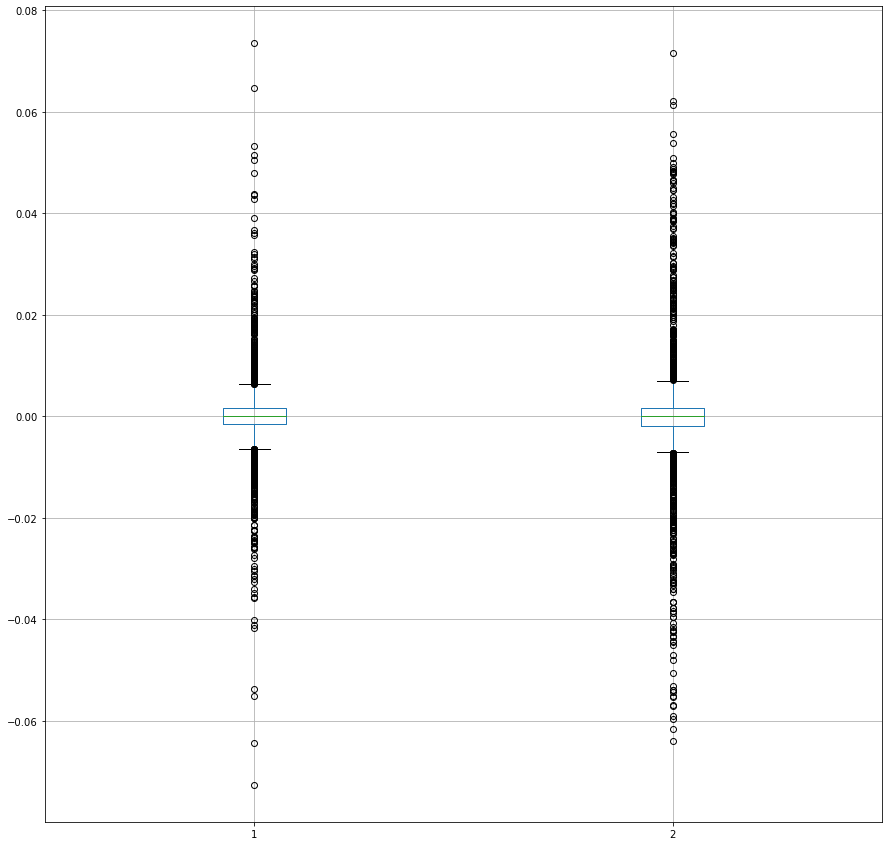

In [ ]:
df1.boxplot(column=['1','2'],figsize =(15,15))

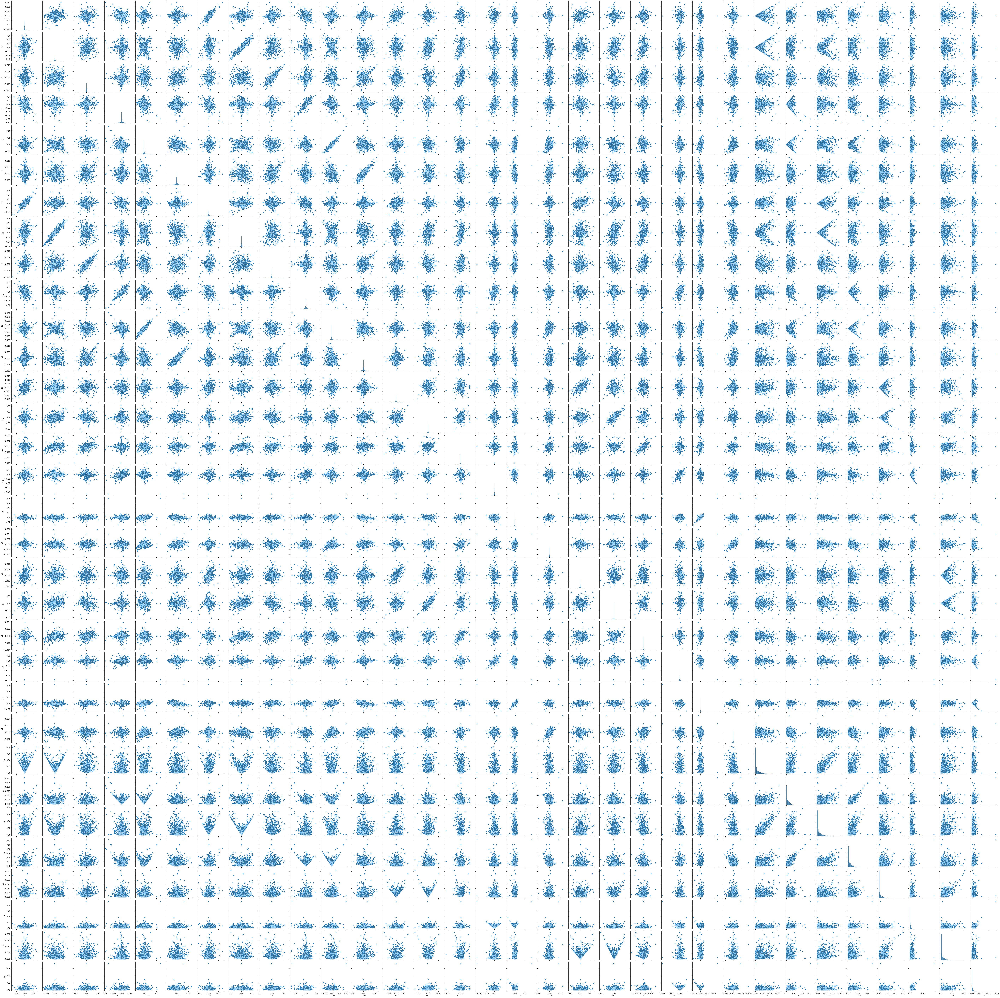

In [ ]:
sns.pairplot(df1)

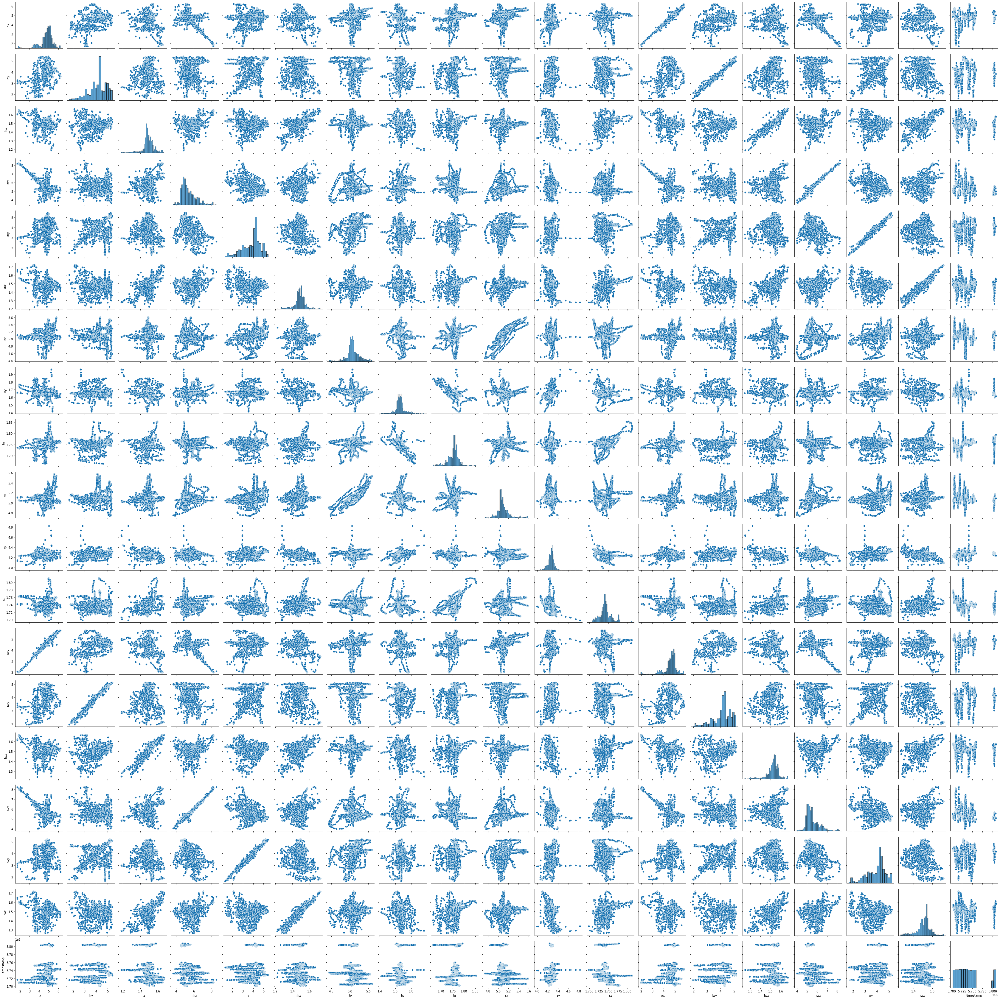

In [ ]:
sns.pairplot(df2)

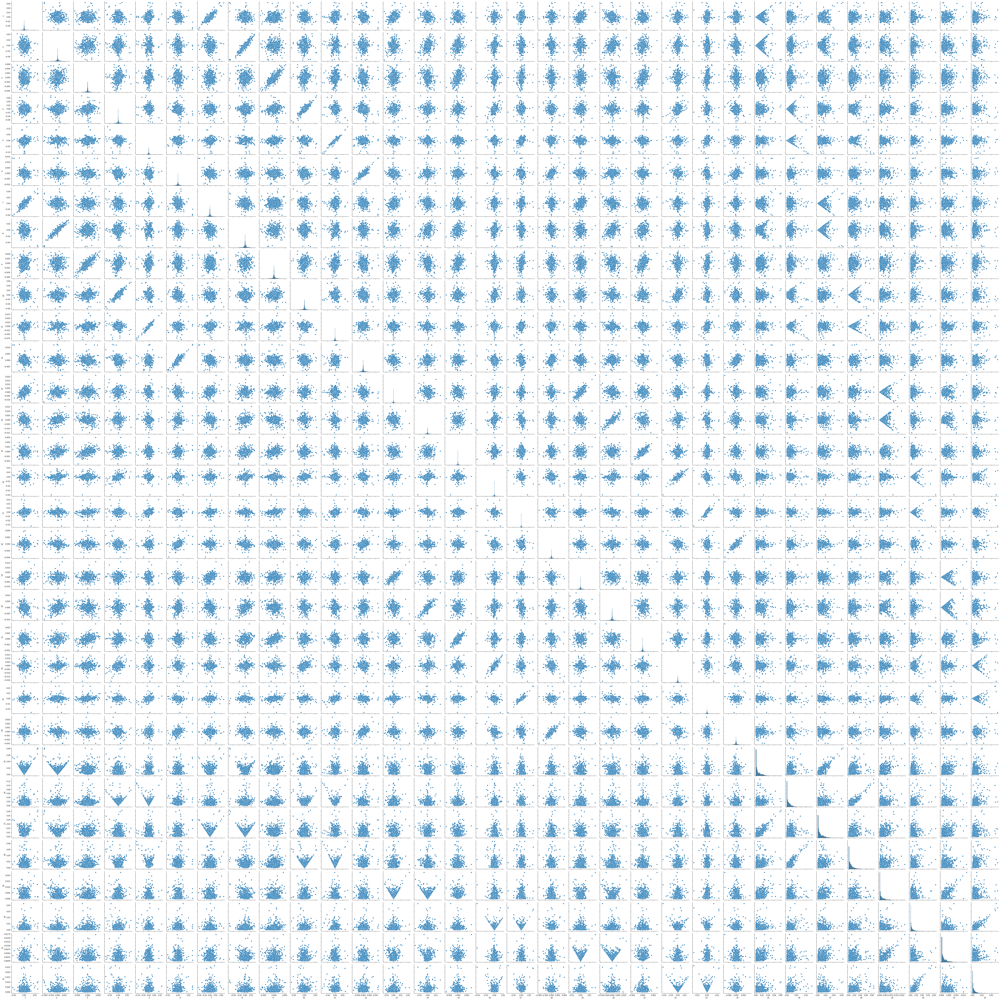

In [ ]:
sns.pairplot(df3)

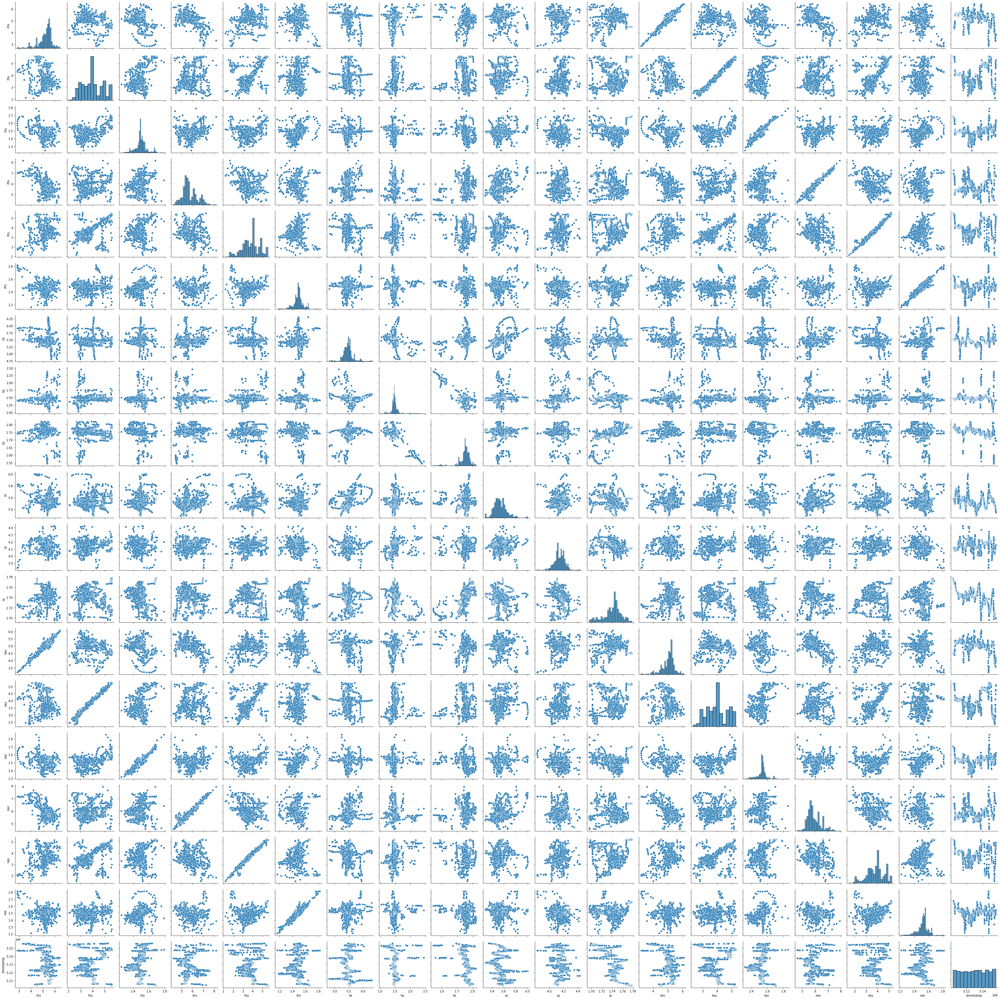

In [ ]:
sns.pairplot(df4)